**Projeto de SCC0252 - Visualização Computacional**

Alunos:

Eduarda Fritzen Neumann - 12556973

# Imports

In [324]:
# !pip install altair==5.4.1
# !pip install openml

import openml
import pandas as pd
import seaborn as sns
import missingno as msno
import numpy as np
import matplotlib.pyplot as plt
import altair as alt

alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

# Introdução ao dataset

In [325]:
dataset = openml.datasets.get_dataset(43533)
df = dataset.get_data()[0]
df.head()

,title,mediaType,eps,duration,ongoing,startYr,finishYr,sznOfRelease,description,studios,tags,contentWarn,watched,watching,wantWatch,dropped,rating,votes
0,Fullmetal Alchemist: Brotherhood,TV,64.0,NaN,False,2009.0,2010.0,Spring,The foundation of alchemy is based on the law ...,['Bones'],"['Action', 'Adventure', 'Drama', 'Fantasy', 'M...","['Animal Abuse', 'Mature Themes', 'Violence', ...",103707.0,14351,25810,2656,4.702,86547.0
1,your name.,Movie,1.0,107.0,False,2016.0,2016.0,None,Mitsuha and Taki are two total strangers livin...,['CoMix Wave Films'],"['Drama', 'Romance', 'Body Swapping', 'Gender ...",[],58831.0,1453,21733,124,4.663,43960.0
2,A Silent Voice,Movie,1.0,130.0,False,2016.0,2016.0,None,"After transferring into a new school, a deaf g...",['Kyoto Animation'],"['Drama', 'Shounen', 'Disability', 'Melancholy...","['Bullying', 'Mature Themes', 'Suicide']",45892.0,946,17148,132,4.661,33752.0
3,Haikyuu!! Karasuno High School vs Shiratorizaw...,TV,10.0,NaN,False,2016.0,2016.0,Fall,"Picking up where the second season ended, the ...",['Production I.G'],"['Shounen', 'Sports', 'Animeism', 'School Club...",[],25134.0,2183,8082,167,4.660,17422.0
4,Attack on Titan 3rd Season: Part II,TV,10.0,NaN,False,2019.0,2019.0,Spring,The battle to retake Wall Maria begins now! Wi...,['Wit Studio'],"['Action', 'Fantasy', 'Horror', 'Shounen', 'Da...","['Cannibalism', 'Explicit Violence']",21308.0,3217,7864,174,4.650,15789.0


# Questões potenciais

correlação entre eps e drops

correlação entre anos de duração e drops

correlação entre rating e publico

correlação entre rating e drops

correlacao contWarning e drops

correlação entre rating e votes

comparar drops, rating e publico nos tipos de media e tags

quantidade de shows que começaram por ano

quais sao os melhores studios (mais rating, mais publico e menos drop)




# Pré processamento

## Tratamento dos dados faltantes

<Axes: >

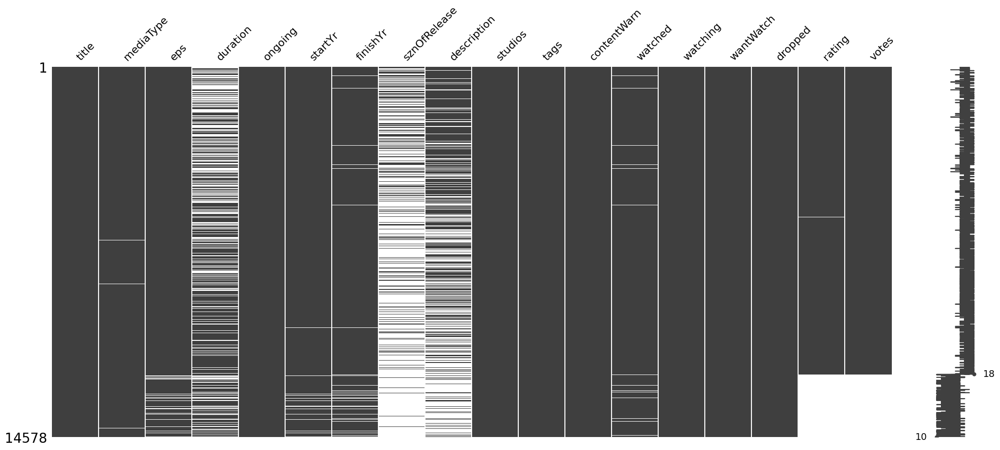

In [326]:
msno.matrix(df)

<Axes: >

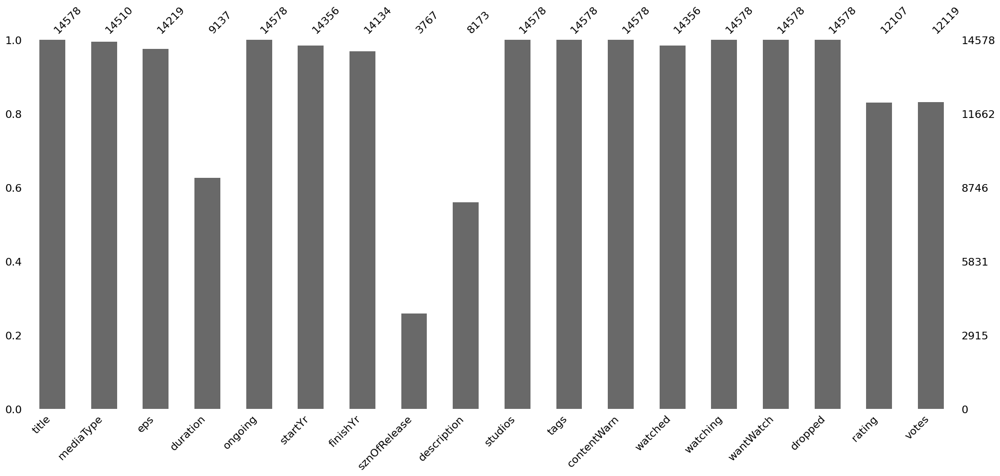

In [327]:
msno.bar(df)

### Tipo de media

Em instâncias com valor de 'mediaType' nulo e com número de episódios igual a 1, fez-se imputação de tipo de media como filme.

In [328]:
df.loc[df['eps']==1 & df['mediaType'].isnull(), 'mediaType'] = 'Movie'

### Ano de fim

Em instâncias onde a coluna 'ongoing' é verdadeira e o ano de fim é nulo, fez-se imputação do ano de fim como 2020, ano que o dataset foi extraído.

In [329]:
df.loc[(df['ongoing']==True) & (df['finishYr'].isnull()), 'finishYr'] = 2020

### Pessoas que assistiram

In [330]:
df.loc[(df['ongoing']==True), 'watched'] = 0

### Colunas de duração, descrição e estação do lançamento

Por possuírem uma quantidade grande demais de valores nulos, tais colunas foram excluídas do dataset.

In [331]:
df.drop(['duration', 'sznOfRelease', 'description'], inplace=True, axis=1, errors='ignore')

### Outros valores nulos

Outras linhas com algum valor nulo foram excluídas do dataset.

In [332]:
df.dropna(how='any', inplace=True)

### Resultado

<Axes: >

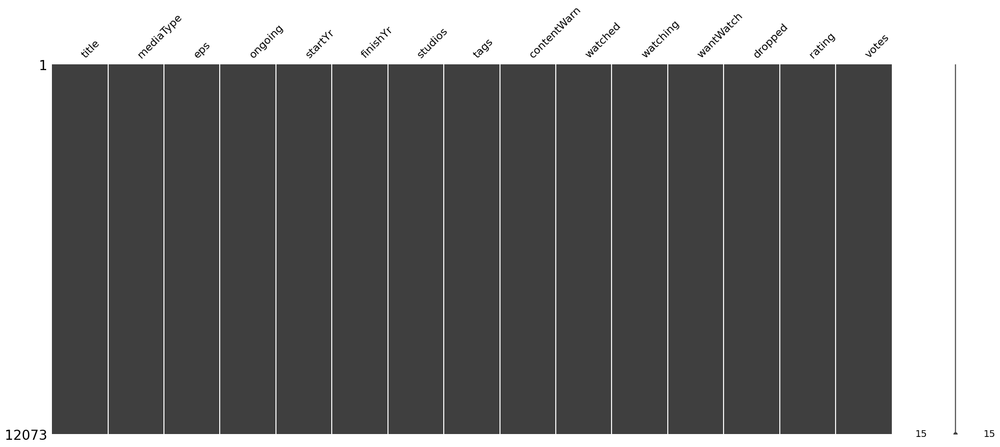

In [333]:
msno.matrix(df)

<Axes: >

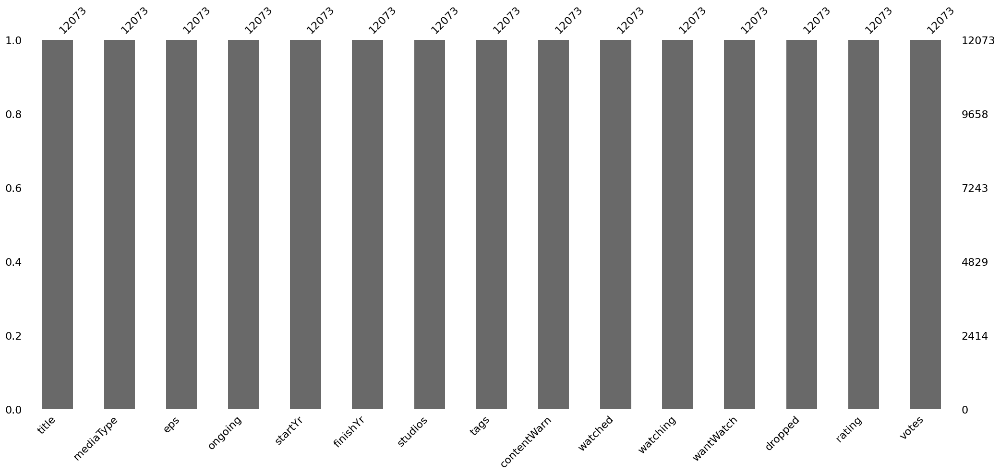

In [334]:
msno.bar(df)

In [335]:
df.isnull().sum()

title          0
mediaType      0
eps            0
ongoing        0
startYr        0
finishYr       0
studios        0
tags           0
contentWarn    0
watched        0
watching       0
wantWatch      0
dropped        0
rating         0
votes          0
dtype: int64

## Criação de novas features

### Quantidade total de público

Criar uma coluna 'audience' somando as colunas 'watched' e 'watching'.

In [336]:
df['audience'] = df['watched'] + df['watching']

### Duração em anos

Criar uma coluna 'durationYrs' subtraindo 'finishYr' e 'startYr'

In [337]:
df['durationYrs'] = df['finishYr'] - df['startYr']

### Porcentagem de desistência

In [338]:
df['droppedPercentage'] = df['dropped']/df['audience'].replace({ 0 : np.nan })
df.loc[df['droppedPercentage'].isnull(), 'droppedPercentage'] = 0

## Redução de dimensionalidade

Remoção de atributos redundantes ou não interessantes para a análise realizada.

In [339]:
df.drop(['finishYr', 'watched', 'watching', 'wantWatch', 'dropped', 'votes', 'tags', 'contentWarn', 'studios', 'votesPercentage'], inplace=True, axis=1, errors='ignore')

# Exploração dos dados

## Análise individual de cada atributo e identificação de outliers

### Número de episódios

In [340]:
bp = alt.Chart(df).mark_boxplot().encode(
    alt.Y("eps:Q").scale(zero=False)
).properties(
    width=200,
    height=300
)

hist = alt.Chart(df).mark_bar().encode(
    alt.X("eps:Q", bin=alt.Bin(step=50)),
    y='count()',
)

bp | hist

alt.HConcatChart(...)

In [341]:
df.loc[df['eps']>2500]

,title,mediaType,eps,ongoing,startYr,rating,audience,durationYrs,droppedPercentage
7153,Sazae-san,TV,2527.0,True,1969.0,2.737,233.0,51.0,0.32618


In [342]:
len(df.loc[df['eps']==1].index)/len(df.index)

0.4926695933073801

### Ano de lançamento

In [343]:
bp = alt.Chart(df).mark_boxplot().encode(
    alt.Y("startYr:Q").scale(zero=False)
).properties(
    width=200,
    height=300
)

hist = alt.Chart(df).mark_bar().encode(
    alt.X("startYr:Q", bin=alt.Bin(step=5)),
    y='count()',
)

bp | hist

alt.HConcatChart(...)

In [344]:
df.loc[df['startYr']<1920]

,title,mediaType,eps,ongoing,startYr,rating,audience,durationYrs,droppedPercentage
9274,Namakura Gatana,Movie,1.0,False,1917.0,2.258,330.0,0.0,0.003030
9964,Katsudou Shashin,Movie,1.0,False,1907.0,2.083,400.0,0.0,0.007500
11154,Hanasaka Jijii,Movie,1.0,False,1917.0,1.720,37.0,0.0,0.000000
11242,Urashima Tarou (1918),Movie,1.0,False,1918.0,1.689,181.0,0.0,0.005525


### Duração

In [345]:
bp = alt.Chart(df).mark_boxplot().encode(
    alt.Y("durationYrs:Q").scale(zero=False)
).properties(
    width=200,
    height=300
)

hist = alt.Chart(df).mark_bar().encode(
    alt.X("durationYrs:Q", bin=alt.Bin(step=1)),
    y='count()',
)

bp | hist

alt.HConcatChart(...)

In [346]:
df.loc[df['durationYrs']>50]

,title,mediaType,eps,ongoing,startYr,rating,audience,durationYrs,droppedPercentage
7153,Sazae-san,TV,2527.0,True,1969.0,2.737,233.0,51.0,0.32618


In [347]:
len(df.loc[df['durationYrs']==1].index)/len(df.index)

0.1525718545514785

### Público

In [348]:
bp = alt.Chart(df).mark_boxplot().encode(
    alt.Y("audience:Q").scale(zero=False)
).properties(
    width=200,
    height=300
)

hist = alt.Chart(df).mark_bar().encode(
    alt.X("audience:Q", bin=alt.Bin(step=10000)),
    y='count()',
)

bp | hist

alt.HConcatChart(...)

In [349]:
df.loc[df['audience']>160000]

,title,mediaType,eps,ongoing,startYr,rating,audience,durationYrs,droppedPercentage
97,Death Note,TV,37.0,False,2006.0,4.501,172615.0,1.0,0.045361


In [350]:
len(df.loc[df['audience']==0])/len(df.index)

0.0005798061790772799

### Porcentagem de desistência

In [351]:
bp = alt.Chart(df).mark_boxplot().encode(
    alt.Y("droppedPercentage:Q").scale(zero=False)
).properties(
    width=200,
    height=300
)

hist = alt.Chart(df).mark_bar().encode(
    alt.X("droppedPercentage:Q", bin=alt.Bin(step=0.05)),
    y='count()',
)

bp | hist

alt.HConcatChart(...)

In [352]:
df.loc[df['droppedPercentage']>1]

,title,mediaType,eps,ongoing,startYr,rating,audience,durationYrs,droppedPercentage
12100,Forest Fairy Five,TV,13.0,False,2017.0,1.002,99.0,0.0,1.070707


In [353]:
len(df.loc[df['droppedPercentage']==0])/len(df.index)

0.11662387144868715

In [354]:
len(df.loc[(df['droppedPercentage']==0) & (df['audience']>0)])/len(df.index)

0.11604406526960988

### Nota

In [355]:
bp = alt.Chart(df).mark_boxplot().encode(
    alt.Y("rating:Q").scale(zero=False)
).properties(
    width=200,
    height=300
)

hist = alt.Chart(df).mark_bar().encode(
    alt.X("rating:Q", bin=alt.Bin(step=0.2),),
    y='count()',
)

bp | hist

alt.HConcatChart(...)

### Em lançamento

In [356]:
alt.Chart(df).mark_bar().encode(
    alt.X('ongoing:N', sort='-y'),
    alt.Y('count():Q')
).properties(
    width=500,
    height=300
)

alt.Chart(...)

### Tipos de medias

In [357]:
alt.Chart(df).mark_bar().encode(
    alt.X('mediaType:N', sort='-y'),
    alt.Y('count():Q')
).properties(
    width=500,
    height=300
)

alt.Chart(...)

## Análise conjunta dos atributos quantitativos

In [358]:
columns_num = ['eps', 'startYr', 'durationYrs', 'audience', 'droppedPercentage', 'rating']
df_num = df[columns_num]
df_num.head(5)

,eps,startYr,durationYrs,audience,droppedPercentage,rating
0,64.0,2009.0,1.0,118058.0,0.022497,4.702
1,1.0,2016.0,0.0,60284.0,0.002057,4.663
2,1.0,2016.0,0.0,46838.0,0.002818,4.661
3,10.0,2016.0,0.0,27317.0,0.006113,4.660
4,10.0,2019.0,0.0,24525.0,0.007095,4.650


In [359]:
df_num.cov().style.background_gradient(cmap='Blues')

,eps,startYr,durationYrs,audience,droppedPercentage,rating
eps,3361.416126,-71.468766,52.208245,32284.115689,1.075304,2.113319
startYr,-71.468766,205.531148,-1.698469,7692.406942,0.040120,2.016565
durationYrs,52.208245,-1.698469,1.329514,493.743284,0.018786,0.047304
audience,32284.115689,7692.406942,493.743284,71143907.515127,-41.441807,2869.978371
droppedPercentage,1.075304,0.040120,0.018786,-41.441807,0.007093,-0.009879
rating,2.113319,2.016565,0.047304,2869.978371,-0.009879,0.684670


In [360]:
df_num.corr().style.background_gradient(cmap='Blues')

,eps,startYr,durationYrs,audience,droppedPercentage,rating
eps,1.000000,-0.085984,0.780965,0.066017,0.220223,0.044052
startYr,-0.085984,1.000000,-0.102748,0.063614,0.033229,0.169994
durationYrs,0.780965,-0.102748,1.000000,0.050768,0.193459,0.049580
audience,0.066017,0.063614,0.050768,1.000000,-0.058339,0.411215
droppedPercentage,0.220223,0.033229,0.193459,-0.058339,1.000000,-0.141767
rating,0.044052,0.169994,0.049580,0.411215,-0.141767,1.000000


In [361]:
alt.Chart(df).mark_circle().encode(
    alt.X(alt.repeat("column"), type='quantitative').scale(zero=False),
    alt.Y(alt.repeat("row"), type='quantitative').scale(zero=False),
    color='mediaType:N'
).properties(
    width=150,
    height=150
).repeat(
    row=columns_num,
    column=columns_num
).interactive()

alt.RepeatChart(...)

# Discussões

## Existe relação entre o comprimento de uma série e a porcentagem de desistência?

In [362]:
alt.Chart(df).mark_circle().encode(
    alt.X(alt.repeat("column"), type='quantitative').scale(zero=False),
    alt.Y(alt.repeat("row"), type='quantitative').scale(zero=False),
    color='mediaType:N'
).properties(
    width=200,
    height=200
).repeat(
    row=['eps', 'durationYrs', 'droppedPercentage'],
    column=['eps', 'durationYrs', 'droppedPercentage']
).interactive()

alt.RepeatChart(...)

In [363]:
media_type_df = df[['mediaType', 'droppedPercentage', 'eps']].groupby('mediaType').mean()
media_type_df.reset_index(inplace=True)
media_type_df.sort_values('eps', inplace=True)

dropped = alt.Chart(media_type_df).mark_bar().encode(
    alt.X('droppedPercentage'),
    alt.Y('mediaType', sort=alt.EncodingSortField(field="droppedPercentage"))
).properties(height=350).interactive()

eps = alt.Chart(media_type_df).mark_bar().encode(
    alt.X('eps'),
    alt.Y('mediaType', sort=alt.EncodingSortField(field="droppedPercentage"))
).properties(height=350).interactive()

dropped | eps


alt.HConcatChart(...)

## Anos que shows começam

In [364]:
gb = pd.DataFrame(df.value_counts(subset=['startYr'])).reset_index()
gb.drop(gb[gb['startYr']>2019].index, inplace=True)
alt.Chart(gb).mark_line().encode(
    x='startYr',
    y='count'
).properties(height=400, width=500).interactive()

alt.Chart(...)

In [365]:
gb = pd.DataFrame(df.value_counts(subset=['startYr', 'mediaType'])).reset_index()
gb.drop(gb[gb['startYr']>2019].index, inplace=True)
line = alt.Chart(gb).mark_line().encode(
    x='startYr',
    y='count',
    color='mediaType'
).properties(height=500, width=500).interactive()

gb = pd.DataFrame(df.value_counts(subset=['startYr', 'mediaType'])).reset_index()
gb.sort_values('count', inplace=True)
gb.drop(gb[gb['startYr']>2019].index, inplace=True)
bar = alt.Chart(gb).mark_bar().encode(
    x='startYr',
    y='count',
    color='mediaType'
).properties(height=500, width=500).interactive()

line | bar

alt.HConcatChart(...)

In [366]:
alt.Chart(df).mark_bar().encode(
    alt.X('startYr', bin=alt.Bin(step=5)),
    alt.Y('count()', sort='-x'),
    color=alt.Color('mediaType')
).properties(
    height=100, 
    width=100
).interactive().facet(
    facet=alt.Facet('mediaType:N', sort=alt.SortField("sort_val", order="descending")),
    columns=3
)

alt.FacetChart(...)

## Rascunho

<Axes: xlabel='mediaType', ylabel='rating'>

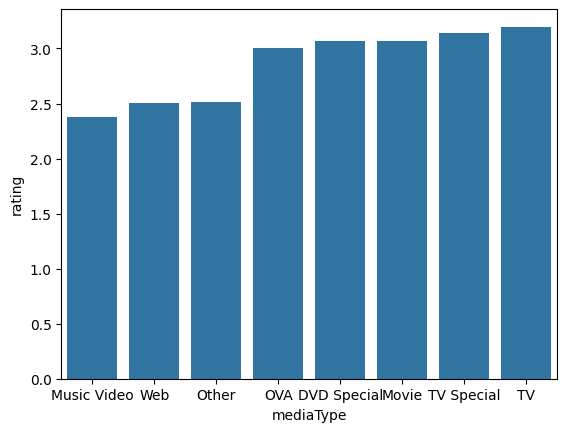

In [367]:
media_type_ratings = df[['mediaType', 'rating']].groupby('mediaType').mean()
media_type_ratings.sort_values('rating', inplace=True)
sns.barplot(media_type_ratings['rating'])

<Axes: xlabel='mediaType', ylabel='audience'>

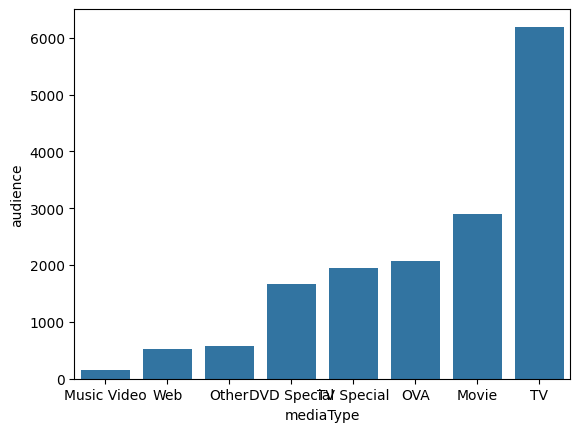

In [368]:
media_type_audiences = df[['mediaType', 'audience']].groupby('mediaType').mean()
media_type_audiences.sort_values('audience', inplace=True)
sns.barplot(media_type_audiences['audience'])